In [1]:
import sys
sys.path.append('../')
import numpy as np
from IPython.display import HTML

from rover_simulator.sensor import ImaginalStereoCamera, ImaginalLiDAR
from rover_simulator.world import World
from rover_simulator.rover import DwaRover
from rover_simulator.navigation.controller import DwaController
from rover_simulator.history import SimpleHistory
from rover_simulator.navigation.localizer import ImaginalLocalizer
from rover_simulator.collision_detector import CollisionDetector

In [2]:
world = World()
world.read_objects("../rover_simulator/examples/environment_simple.txt")

In [3]:
start_pose = np.array([1.0, 1.0, 0.0])
waypoint_pos = np.array([12, 18])

sensor = ImaginalLiDAR(obstacles=world.obstacles)
controller = DwaController(omega_delta=np.deg2rad(20), rover_r=0.5, sensor_type=sensor.type)
history = SimpleHistory(sensor=sensor)
rover = DwaRover(
    start_pose, 0.5,
    sensor=sensor,
    controller=controller,
    localizer=ImaginalLocalizer(),
    history=history,
    collision_detector=CollisionDetector(world.obstacles),
    waypoint_pos=waypoint_pos
)
world.append_rover(rover)

In [4]:
world.simulate(200)

  0%|          | 0/200 [00:00<?, ?it/s]

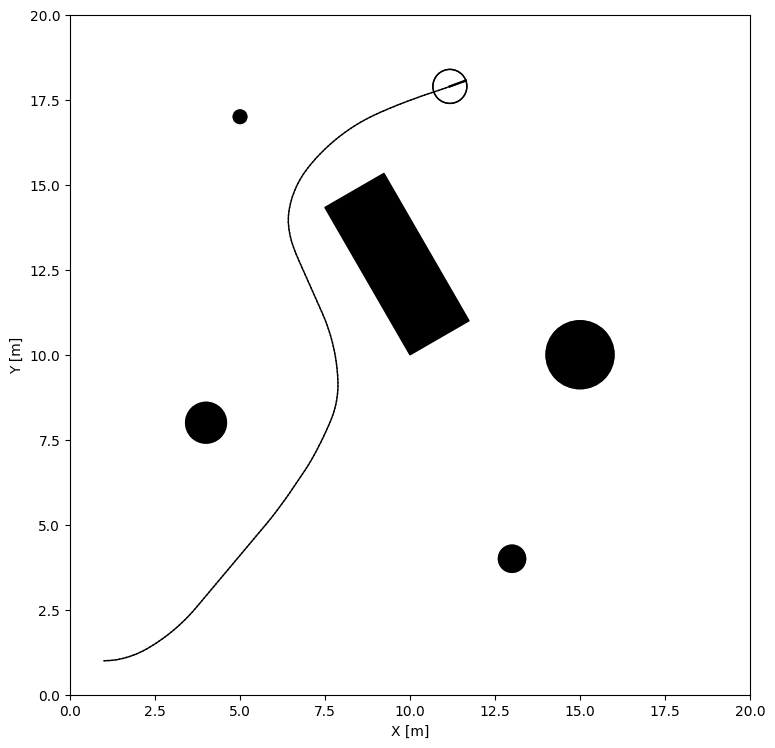

In [5]:
history.draw(
    xlim=[0, 20], ylim=[0, 20],
    obstacles=world.obstacles,
    # expand_dist=rover.r
)

In [6]:
controller.animate(
    xlim=[0, 20], ylim=[0, 20],
    obstacles=world.obstacles,
    start_pos=start_pose[:2],
    goal_pos=rover.waypoint,
    rover_poses=rover.history.real_poses,
    end_step=world.step
)
HTML(controller.ani.to_jshtml())

  0%|          | 0/200 [00:00<?, ?it/s]

In [7]:
history.animate(
    xlim=[0, 20], ylim=[0, 20],
    start_pos=start_pose[0:2], goal_pos=rover.waypoint,
    obstacles=world.obstacles,
    draw_sensing_results_flag=True
    # expand_dist=rover.r
)
HTML(history.ani.to_jshtml())

  0%|          | 0/200 [00:00<?, ?it/s]